In [1]:
import warnings
warnings.simplefilter("ignore")
warnings.filterwarnings("ignore")

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt 
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from scipy.stats import zscore
from imblearn.over_sampling import SMOTE
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.neighbors import KNeighborsClassifier
import xgboost as xgb
import lightgbm as lgb

from sklearn import metrics
from sklearn.metrics import classification_report
from sklearn.metrics import accuracy_score
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV

In [2]:
df = pd.read_csv("water_potability.csv") # Data Source: https://www.kaggle.com/datasets/adityakadiwal/water-potability
df

,ph,Hardness,Solids,Chloramines,Sulfate,Conductivity,Organic_carbon,Trihalomethanes,Turbidity,Potability
0,NaN,204.890455,20791.318981,7.300212,368.516441,564.308654,10.379783,86.990970,2.963135,0
1,3.716080,129.422921,18630.057858,6.635246,NaN,592.885359,15.180013,56.329076,4.500656,0
2,8.099124,224.236259,19909.541732,9.275884,NaN,418.606213,16.868637,66.420093,3.055934,0
3,8.316766,214.373394,22018.417441,8.059332,356.886136,363.266516,18.436524,100.341674,4.628771,0
4,9.092223,181.101509,17978.986339,6.546600,310.135738,398.410813,11.558279,31.997993,4.075075,0
...,...,...,...,...,...,...,...,...,...,...
3271,4.668102,193.681735,47580.991603,7.166639,359.948574,526.424171,13.894419,66.687695,4.435821,1
3272,7.808856,193.553212,17329.802160,8.061362,NaN,392.449580,19.903225,NaN,2.798243,1
3273,9.419510,175.762646,33155.578218,7.350233,NaN,432.044783,11.039070,69.845400,3.298875,1
3274,5.126763,230.603758,11983.869376,6.303357,NaN,402.883113,11.168946,77.488213,4.708658,1


The water_potability.csv file contains water quality metrics for 3276 different water bodies. Description on each of the columns present the in above dataset is explained below:

1. pH value:
PH is an important parameter in evaluating the acid–base balance of water. It is also the indicator of acidic or alkaline condition of water status. WHO has recommended maximum permissible limit of pH from 6.5 to 8.5. The current investigation ranges were 6.52–6.83 which are in the range of WHO standards.

2. Hardness:
Hardness is mainly caused by calcium and magnesium salts. These salts are dissolved from geologic deposits through which water travels. The length of time water is in contact with hardness producing material helps determine how much hardness there is in raw water. Hardness was originally defined as the capacity of water to precipitate soap caused by Calcium and Magnesium.

3. Solids (Total dissolved solids - TDS):
Water has the ability to dissolve a wide range of inorganic and some organic minerals or salts such as potassium, calcium, sodium, bicarbonates, chlorides, magnesium, sulfates etc. These minerals produced un-wanted taste and diluted color in appearance of water. This is the important parameter for the use of water. The water with high TDS value indicates that water is highly mineralized. Desirable limit for TDS is 500 mg/l and maximum limit is 1000 mg/l which prescribed for drinking purpose.

4. Chloramines:
Chlorine and chloramine are the major disinfectants used in public water systems. Chloramines are most commonly formed when ammonia is added to chlorine to treat drinking water. Chlorine levels up to 4 milligrams per liter (mg/L or 4 parts per million (ppm)) are considered safe in drinking water.

5. Sulfate:
Sulfates are naturally occurring substances that are found in minerals, soil, and rocks. They are present in ambient air, groundwater, plants, and food. The principal commercial use of sulfate is in the chemical industry. Sulfate concentration in seawater is about 2,700 milligrams per liter (mg/L). It ranges from 3 to 30 mg/L in most freshwater supplies, although much higher concentrations (1000 mg/L) are found in some geographic locations.

6. Conductivity:
Pure water is not a good conductor of electric current rather’s a good insulator. Increase in ions concentration enhances the electrical conductivity of water. Generally, the amount of dissolved solids in water determines the electrical conductivity. Electrical conductivity (EC) actually measures the ionic process of a solution that enables it to transmit current. According to WHO standards, EC value should not exceeded 400 μS/cm.

7. Organic_carbon:
Total Organic Carbon (TOC) in source waters comes from decaying natural organic matter (NOM) as well as synthetic sources. TOC is a measure of the total amount of carbon in organic compounds in pure water. According to US EPA < 2 mg/L as TOC in treated / drinking water, and < 4 mg/Lit in source water which is use for treatment.

8. Trihalomethanes:
THMs are chemicals which may be found in water treated with chlorine. The concentration of THMs in drinking water varies according to the level of organic material in the water, the amount of chlorine required to treat the water, and the temperature of the water that is being treated. THM levels up to 80 ppm is considered safe in drinking water.

9. Turbidity:
The turbidity of water depends on the quantity of solid matter present in the suspended state. It is a measure of light emitting properties of water and the test is used to indicate the quality of waste discharge with respect to colloidal matter. The mean turbidity value obtained for Wondo Genet Campus (0.98 NTU) is lower than the WHO recommended value of 5.00 NTU.

10. Potability:
Indicates if water is safe for human consumption where 1 means Potable and 0 means Not potable.

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3276 entries, 0 to 3275
Data columns (total 10 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   ph               2785 non-null   float64
 1   Hardness         3276 non-null   float64
 2   Solids           3276 non-null   float64
 3   Chloramines      3276 non-null   float64
 4   Sulfate          2495 non-null   float64
 5   Conductivity     3276 non-null   float64
 6   Organic_carbon   3276 non-null   float64
 7   Trihalomethanes  3114 non-null   float64
 8   Turbidity        3276 non-null   float64
 9   Potability       3276 non-null   int64  
dtypes: float64(9), int64(1)
memory usage: 256.1 KB


With the `info` we can see that the datatypes for all the columns are float and just the "Potability" column contains integer datatype values

In [4]:
df.isna().sum()

ph                 491
Hardness             0
Solids               0
Chloramines          0
Sulfate            781
Conductivity         0
Organic_carbon       0
Trihalomethanes    162
Turbidity            0
Potability           0
dtype: int64

Using the null function with sum fuction was able to check that we do have missing values present in our used dataset that will need to be taken care of either by imputation or by dropping them completely if no meaningful value replacement is observed.

In [5]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
ph,2785.0,7.080795,1.594320,0.000000,6.093092,7.036752,8.062066,14.000000
Hardness,3276.0,196.369496,32.879761,47.432000,176.850538,196.967627,216.667456,323.124000
Solids,3276.0,22014.092526,8768.570828,320.942611,15666.690297,20927.833607,27332.762127,61227.196008
Chloramines,3276.0,7.122277,1.583085,0.352000,6.127421,7.130299,8.114887,13.127000
Sulfate,2495.0,333.775777,41.416840,129.000000,307.699498,333.073546,359.950170,481.030642
Conductivity,3276.0,426.205111,80.824064,181.483754,365.734414,421.884968,481.792304,753.342620
Organic_carbon,3276.0,14.284970,3.308162,2.200000,12.065801,14.218338,16.557652,28.300000
Trihalomethanes,3114.0,66.396293,16.175008,0.738000,55.844536,66.622485,77.337473,124.000000
Turbidity,3276.0,3.966786,0.780382,1.450000,3.439711,3.955028,4.500320,6.739000
Potability,3276.0,0.390110,0.487849,0.000000,0.000000,0.000000,1.000000,1.000000


Observing the above described data most of the columns follow a close to normal distribution pattern however a drastic numeric difference is evidently visibly on "Solids" and "Trihalomethanes" where the max and min data have a huge difference compared to their quartile numbers.

In [6]:
# Calculate descriptive statistics and transpose
df_desc = df.describe().T

# Create heatmap
fig = go.Figure(data=go.Heatmap(
    z=df_desc.values,
    x=df_desc.columns,
    y=df_desc.index,
    colorscale='peach',  # Choose your desired colorscale
    colorbar=dict(title='Value'),
    zmin=df_desc.values.min(),  # Set the minimum value for color scale
    zmax=df_desc.values.max()   # Set the maximum value for color scale
))

# Add text annotations
for i in range(len(df_desc.index)):
    for j in range(len(df_desc.columns)):
        fig.add_annotation(
            x=df_desc.columns[j],
            y=df_desc.index[i],
            text=f'{df_desc.iloc[i, j]:.2f}',  # Format the numbers to display till two decimal places
            showarrow=False,
            font=dict(color='black', size=12),
            xref='x',
            yref='y'
        )

# Update layout
fig.update_layout(
    title='Descriptive Statistics Heatmap',
    xaxis_title='Columns',
    yaxis_title='Statistics',
)

fig.show()

In [7]:
# Create box plot
fig = go.Figure()
for col in df.columns:
    fig.add_trace(go.Box(y=df[col], name=col))

# Update layout
fig.update_layout(title='Box Plot',
                  xaxis_title='Columns',
                  yaxis_title='Values')

fig.show()

With the above boxplot visual we see that "Solids" column is the only one with a higher magnitude numbers plus a difference in the distribution of data points as well.

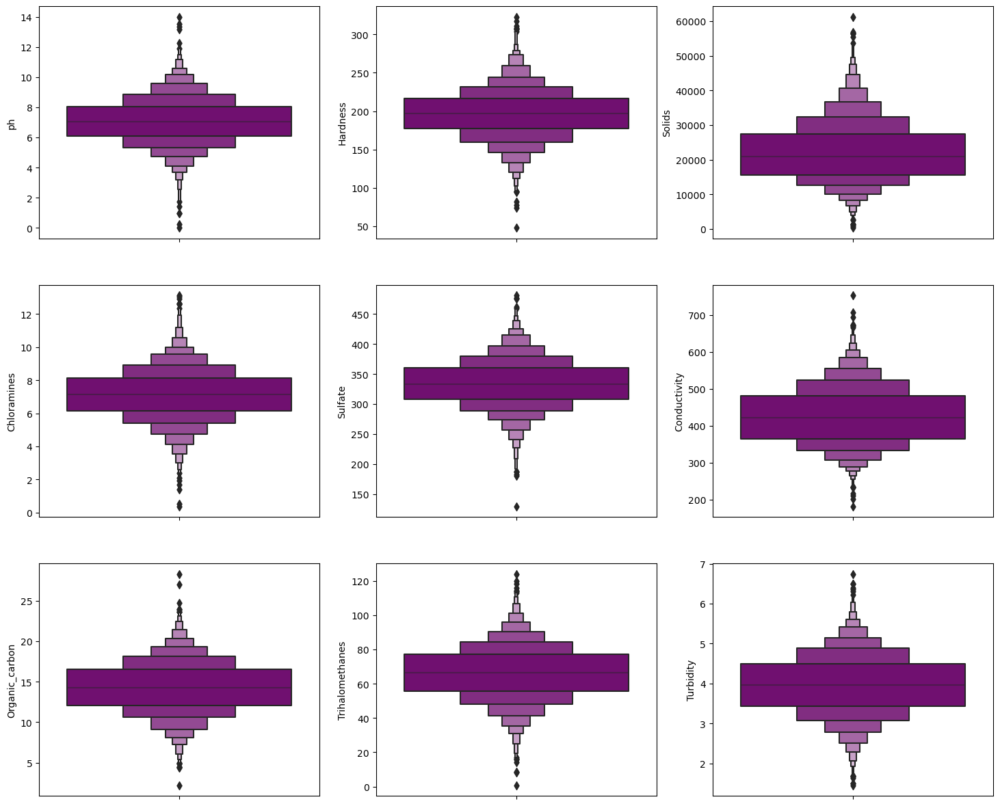

In [8]:
cols = df.drop('Potability', axis=1).columns
fig, ax = plt.subplots(ncols=3, nrows=3, figsize=(18,15))
index = 0
ax = ax.flatten()
for col, value in df[cols].items():
    sns.boxenplot(y=col, data=df, ax=ax[index], color="purple")
    index += 1
plt.show()

In [9]:
df.Potability.value_counts()

Potability
0    1998
1    1278
Name: count, dtype: int64

In [10]:
potability_counts = df['Potability'].value_counts()

fig = go.Figure(data=[go.Bar(x=potability_counts.index, y=potability_counts.values,
                             text=potability_counts.values, textposition='auto',
                             marker=dict(color=['red', 'green']))])
fig.update_layout(xaxis_title='Potability', yaxis_title='Count', xaxis={'type': 'category'})
fig.show()

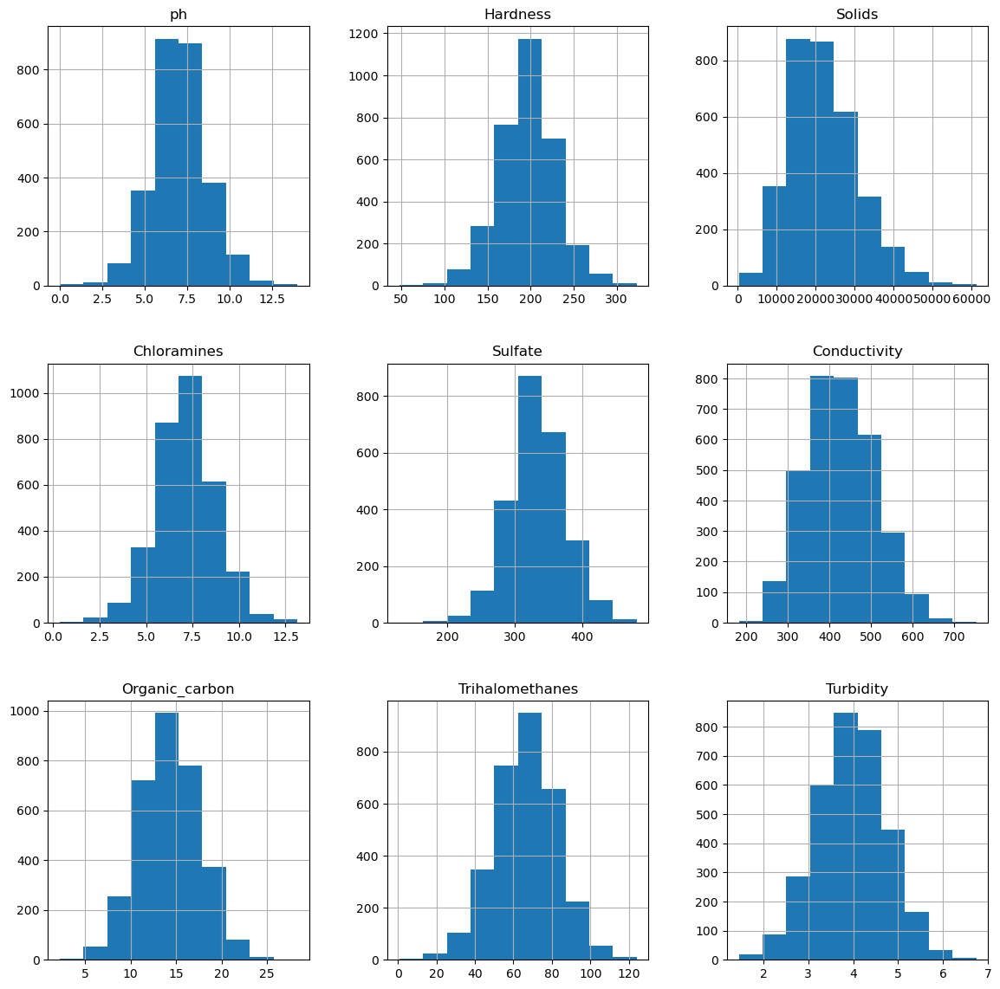

In [11]:
df.drop('Potability', axis=1).hist(figsize=(14,14)) # checking the distribution of data in feature columns
plt.show()

In [12]:
df.skew()

ph                 0.025630
Hardness          -0.039342
Solids             0.621634
Chloramines       -0.012098
Sulfate           -0.035947
Conductivity       0.264490
Organic_carbon     0.025533
Trihalomethanes   -0.083031
Turbidity         -0.007817
Potability         0.450784
dtype: float64

With the `skew` method we see that there are columns present in our dataset that are outside the acceptable range of +/-0.5 (alpha) value. However there is no major or drastic steep with respect to the distribution pattern therefore any transformation should not be required for now.

In [13]:
correlation = df.drop('Potability', axis=1).corr() # dropping the target integer column here
correlation

,ph,Hardness,Solids,Chloramines,Sulfate,Conductivity,Organic_carbon,Trihalomethanes,Turbidity
ph,1.000000,0.082096,-0.089288,-0.034350,0.018203,0.018614,0.043503,0.003354,-0.039057
Hardness,0.082096,1.000000,-0.046899,-0.030054,-0.106923,-0.023915,0.003610,-0.013013,-0.014449
Solids,-0.089288,-0.046899,1.000000,-0.070148,-0.171804,0.013831,0.010242,-0.009143,0.019546
Chloramines,-0.034350,-0.030054,-0.070148,1.000000,0.027244,-0.020486,-0.012653,0.017084,0.002363
Sulfate,0.018203,-0.106923,-0.171804,0.027244,1.000000,-0.016121,0.030831,-0.030274,-0.011187
Conductivity,0.018614,-0.023915,0.013831,-0.020486,-0.016121,1.000000,0.020966,0.001285,0.005798
Organic_carbon,0.043503,0.003610,0.010242,-0.012653,0.030831,0.020966,1.000000,-0.013274,-0.027308
Trihalomethanes,0.003354,-0.013013,-0.009143,0.017084,-0.030274,0.001285,-0.013274,1.000000,-0.022145
Turbidity,-0.039057,-0.014449,0.019546,0.002363,-0.011187,0.005798,-0.027308,-0.022145,1.000000


In [14]:
# Create heatmap for the correlation data
fig = go.Figure(data=go.Heatmap(
    z=correlation.corr().values,
    x=correlation.columns,
    y=correlation.columns,
    colorscale='peach',
    colorbar=dict(title='Correlation'),
    zmin=-1,  # Set the minimum value for color scale
    zmax=1    # Set the maximum value for color scale
))

# Add annotations
for i in range(len(correlation.columns)):
    for j in range(len(correlation.columns)):
        fig.add_annotation(
            x=correlation.columns[j],
            y=correlation.columns[i],
            text=f'{correlation.corr().iloc[i, j]:.2f}',  # Format the text to display two decimal places
            showarrow=False,
            font=dict(color='black', size=12),
            xref='x',
            yref='y'
        )

# Update layout
fig.update_layout(
    title='Correlation Heatmap',
    xaxis_title='Features',
    yaxis_title='Features',
)

fig.show()

In [15]:
correlation_label = df.corr() # correlation with all the original columns
correlation_label

,ph,Hardness,Solids,Chloramines,Sulfate,Conductivity,Organic_carbon,Trihalomethanes,Turbidity,Potability
ph,1.000000,0.082096,-0.089288,-0.034350,0.018203,0.018614,0.043503,0.003354,-0.039057,-0.003556
Hardness,0.082096,1.000000,-0.046899,-0.030054,-0.106923,-0.023915,0.003610,-0.013013,-0.014449,-0.013837
Solids,-0.089288,-0.046899,1.000000,-0.070148,-0.171804,0.013831,0.010242,-0.009143,0.019546,0.033743
Chloramines,-0.034350,-0.030054,-0.070148,1.000000,0.027244,-0.020486,-0.012653,0.017084,0.002363,0.023779
Sulfate,0.018203,-0.106923,-0.171804,0.027244,1.000000,-0.016121,0.030831,-0.030274,-0.011187,-0.023577
Conductivity,0.018614,-0.023915,0.013831,-0.020486,-0.016121,1.000000,0.020966,0.001285,0.005798,-0.008128
Organic_carbon,0.043503,0.003610,0.010242,-0.012653,0.030831,0.020966,1.000000,-0.013274,-0.027308,-0.030001
Trihalomethanes,0.003354,-0.013013,-0.009143,0.017084,-0.030274,0.001285,-0.013274,1.000000,-0.022145,0.007130
Turbidity,-0.039057,-0.014449,0.019546,0.002363,-0.011187,0.005798,-0.027308,-0.022145,1.000000,0.001581
Potability,-0.003556,-0.013837,0.033743,0.023779,-0.023577,-0.008128,-0.030001,0.007130,0.001581,1.000000


In [16]:
# Imputation using the median values of the respective columns because they do not get affected drastically in a non normal data

df['ph'].fillna(value=df['ph'].median(),inplace=True)
df['Sulfate'].fillna(value=df['Sulfate'].median(),inplace=True)
df['Trihalomethanes'].fillna(value=df['Trihalomethanes'].median(),inplace=True)

In [17]:
df.isnull().sum() # No missing values left in our dataset

ph                 0
Hardness           0
Solids             0
Chloramines        0
Sulfate            0
Conductivity       0
Organic_carbon     0
Trihalomethanes    0
Turbidity          0
Potability         0
dtype: int64

In [18]:
df.nunique().sort_values().to_frame("Unique Values")

,Unique Values
Potability,2
Sulfate,2495
ph,2785
Trihalomethanes,3115
Hardness,3276
Solids,3276
Chloramines,3276
Conductivity,3276
Organic_carbon,3276
Turbidity,3276


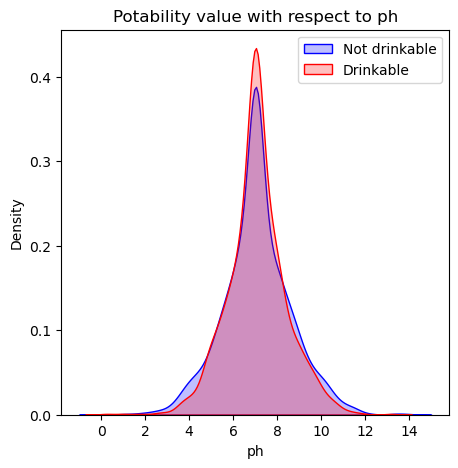

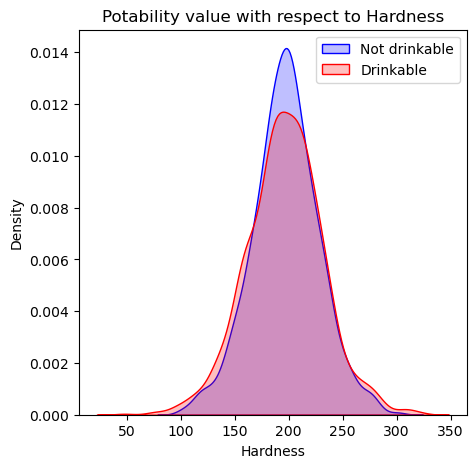

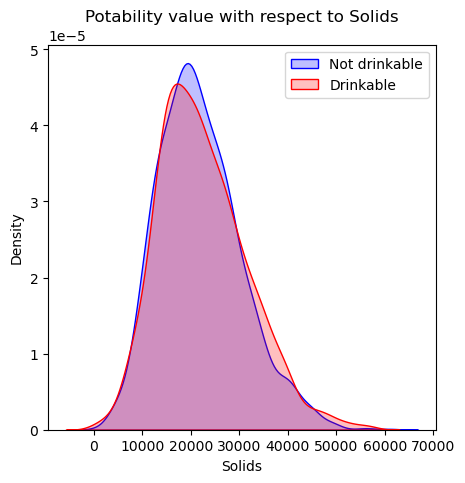

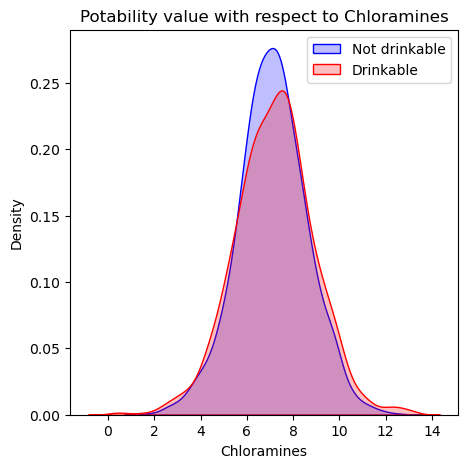

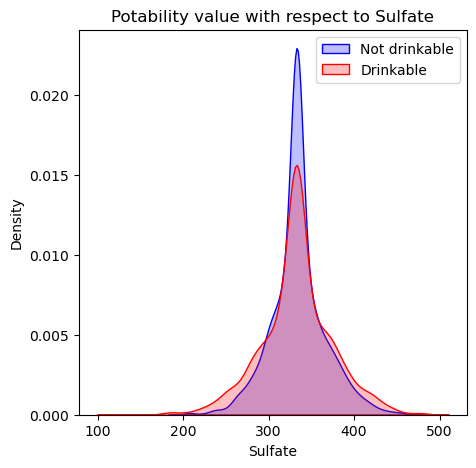

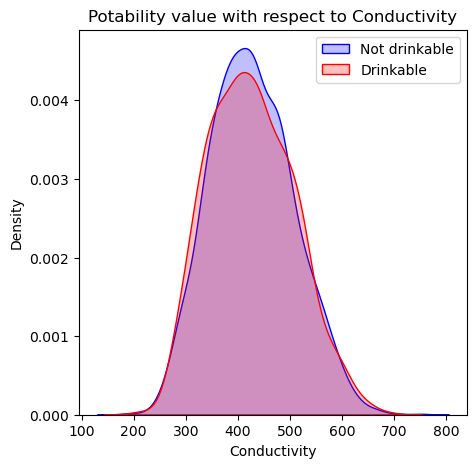

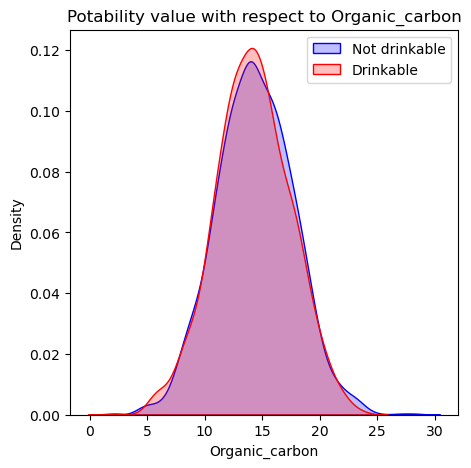

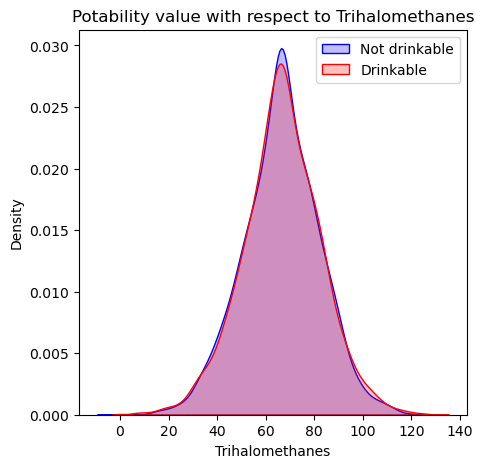

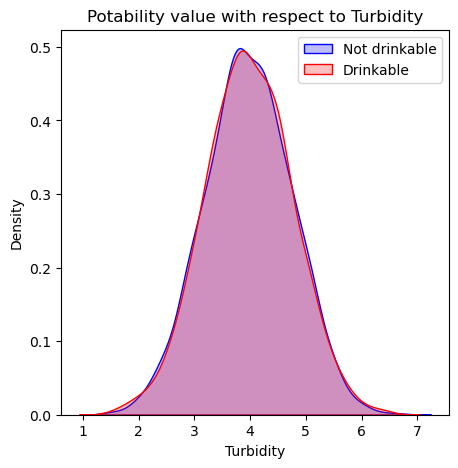

In [19]:
features = df.drop('Potability', axis=1)

for z in df[features.columns]:
    fig = plt.figure(figsize=(5,5))
    ax=sns.kdeplot(df.loc[(df['Potability'] == 0), z], color='b', fill=True, label='Not drinkable') 
    ax=sns.kdeplot(df.loc[(df['Potability'] == 1), z], color='r', fill=True, label='Drinkable')
    plt.title('Potability value with respect to {}'.format(z))
    plt.legend()
    plt.show()

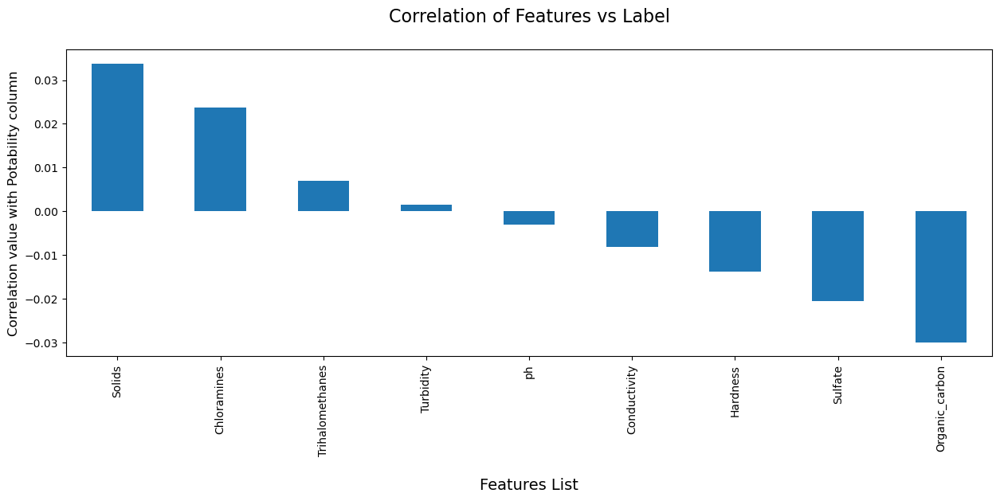

In [20]:
df_corr = df.corr()
plt.figure(figsize=(15,5))
df_corr['Potability'].sort_values(ascending=False).drop('Potability').plot.bar()
plt.title("Correlation of Features vs Label\n", fontsize=16)
plt.xlabel("\nFeatures List", fontsize=14)
plt.ylabel("Correlation value with Potability column", fontsize=12)
plt.show()

In [21]:
z = np.abs(zscore(df))
threshold = 3
dfz = df[(z<3).all(axis = 1)]

print ("Shape of the dataframe before removing outliers: ", df.shape)
print ("Shape of the dataframe after removing outliers: ", dfz.shape)
print ("Percentage of data loss post outlier removal: ", (df.shape[0]-dfz.shape[0])/df.shape[0]*100)

Shape of the dataframe before removing outliers:  (3276, 10)
Shape of the dataframe after removing outliers:  (3128, 10)
Percentage of data loss post outlier removal:  4.517704517704518


Since the data loss is greater using the IQR outlier removal method I will be choosing the Z score outlier removal method here and proceeed with that data.

In [22]:
dfz

,ph,Hardness,Solids,Chloramines,Sulfate,Conductivity,Organic_carbon,Trihalomethanes,Turbidity,Potability
0,7.036752,204.890455,20791.318981,7.300212,368.516441,564.308654,10.379783,86.990970,2.963135,0
1,3.716080,129.422921,18630.057858,6.635246,333.073546,592.885359,15.180013,56.329076,4.500656,0
2,8.099124,224.236259,19909.541732,9.275884,333.073546,418.606213,16.868637,66.420093,3.055934,0
3,8.316766,214.373394,22018.417441,8.059332,356.886136,363.266516,18.436524,100.341674,4.628771,0
4,9.092223,181.101509,17978.986339,6.546600,310.135738,398.410813,11.558279,31.997993,4.075075,0
...,...,...,...,...,...,...,...,...,...,...
3271,4.668102,193.681735,47580.991603,7.166639,359.948574,526.424171,13.894419,66.687695,4.435821,1
3272,7.808856,193.553212,17329.802160,8.061362,333.073546,392.449580,19.903225,66.622485,2.798243,1
3273,9.419510,175.762646,33155.578218,7.350233,333.073546,432.044783,11.039070,69.845400,3.298875,1
3274,5.126763,230.603758,11983.869376,6.303357,333.073546,402.883113,11.168946,77.488213,4.708658,1


In [23]:
dfz.columns

Index(['ph', 'Hardness', 'Solids', 'Chloramines', 'Sulfate', 'Conductivity',
       'Organic_carbon', 'Trihalomethanes', 'Turbidity', 'Potability'],
      dtype='object')

# Bivariate and Multivariate Analysis between the Feature and the labelled Target columns

In [24]:
pd.set_option('display.max_rows', None)

# List of features to calculate statistics for
features = ['ph', 'Hardness', 'Solids', 'Chloramines', 'Sulfate', 
            'Conductivity', 'Organic_carbon', 'Trihalomethanes', 'Turbidity']

# Calculate descriptive statistics for each feature grouped by 'Potability' categories
stats_by_potability = dfz.groupby('Potability')[features].describe().T

# Display the statistics for each feature
stats_by_potability

Potability                        0             1
ph              count   1930.000000   1198.000000
                mean       7.080099      7.064047
                std        1.448855      1.232961
                min        2.690831      2.974429
                25%        6.255090      6.367445
                50%        7.036752      7.036752
                75%        7.911931      7.745157
                max       11.449739     11.244507
Hardness        count   1930.000000   1198.000000
                mean     196.597844    195.842639
                std       30.647503     32.946843
                min       98.452931     98.367915
                25%      177.893268    175.432245
                50%      197.123423    196.632907
                75%      215.911449    216.667169
                max      286.567991    287.975540
Solids          count   1930.000000   1198.000000
                mean   21651.166905  22009.617892
                std     8260.063889   8516.168923
                min      320.942611    728.750830
                25%    15684.598538  15596.765222
                50%    20734.139382  21088.034726
                75%    26854.816581  27456.010791
                max    48175.852093  48007.868134
Chloramines     count   1930.000000   1198.000000
                mean       7.090359      7.138387
                std        1.481372      1.568879
                min        2.456014      2.386653
                25%        6.171827      6.101442
                50%        7.091992      7.197434
                75%        8.065169      8.145611
                max       11.753904     11.523598
Sulfate         count   1930.000000   1198.000000
                mean     334.065571    333.780051
                std       30.611633     38.070543
                min      225.516628    227.348460
                25%      319.402374    315.022972
                50%      333.073546    333.073546
                75%      348.144938    354.753182
                max      439.787938    441.826777
Conductivity    count   1930.000000   1198.000000
                mean     426.312065    425.064330
                std       79.090384     82.255549
                min      210.319182    201.619737
                25%      368.782027    359.819035
                50%      422.053598    420.016381
                75%      480.317842    484.567275
                max      666.690618    657.570422
Organic_carbon  count   1930.000000   1198.000000
                mean      14.348476     14.222177
                std        3.291854      3.273547
                min        4.371899      5.196717
                25%       12.129174     12.067011
                50%       14.303133     14.183216
                75%       16.622181     16.448931
                max       23.952450     23.604298
Trihalomethanes count   1930.000000   1198.000000
                mean      66.349926     66.580949
                std       15.382736     15.466626
                min       22.219327     19.175175
                25%       56.404562     57.213345
                50%       66.622485     66.622485
                75%       76.408263     76.992783
                max      112.412210    113.048886
Turbidity       count   1930.000000   1198.000000
                mean       3.962146      3.968234
                std        0.768885      0.767945
                min        1.680554      1.641515
                25%        3.443474      3.435146
                50%        3.948076      3.954591
                75%        4.482233      4.501190
                max        6.204846      6.226580

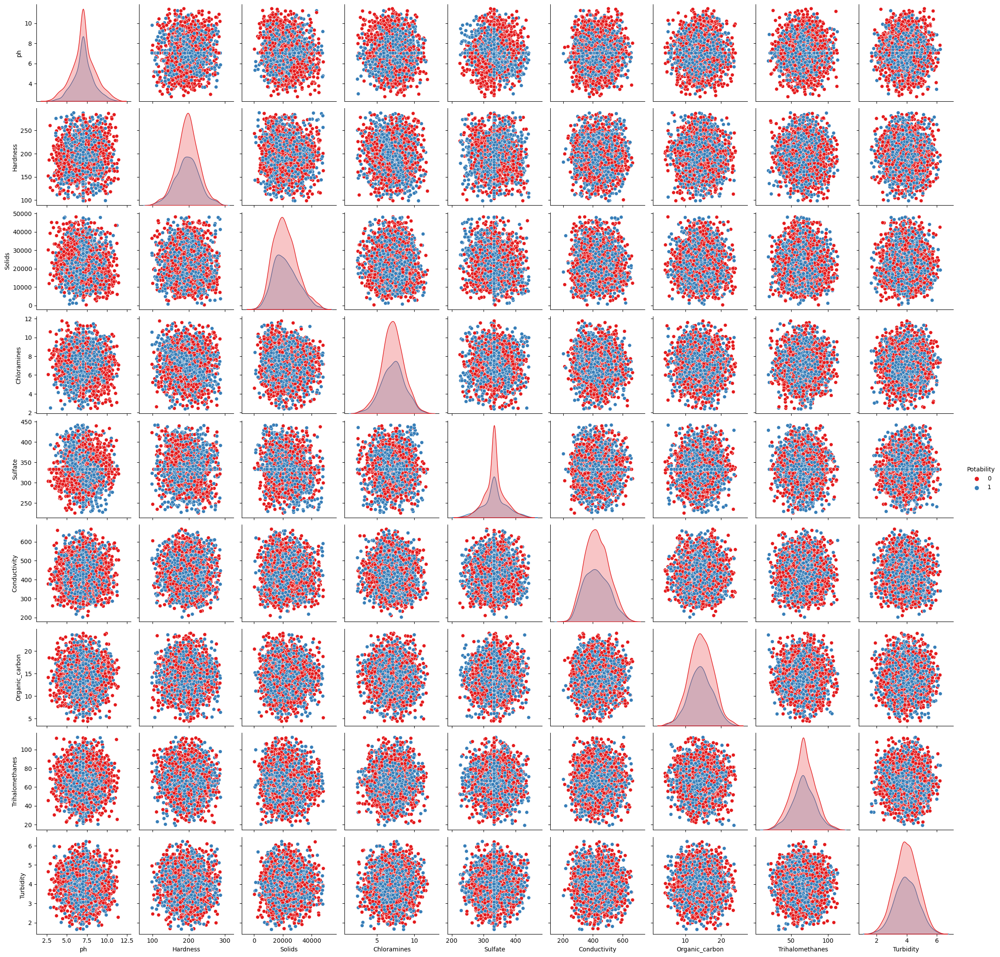

In [25]:
columns_to_plot = ['ph', 'Hardness', 'Solids', 'Chloramines', 'Sulfate', 
                   'Conductivity', 'Organic_carbon', 'Trihalomethanes', 'Turbidity']

# Pairwise scatter plot with color-coded Potability labels
sns.pairplot(dfz, vars=columns_to_plot, hue='Potability', palette='Set1')
plt.show()

In [26]:
# Loop through each column and create scatter plots
for column in columns_to_plot:
    fig = px.scatter(dfz, x=column, color='Potability', title=f'Scatter plot: {column} vs Potability')
    fig.show()

In [27]:
# Loop through each column and create histograms
for column in columns_to_plot:
    fig = px.histogram(dfz, x=column, color='Potability', title=f'Factors Affecting Water Quality: {column}')
    fig.update_layout(barmode='overlay')
    fig.show()

<Figure size 800x600 with 0 Axes>

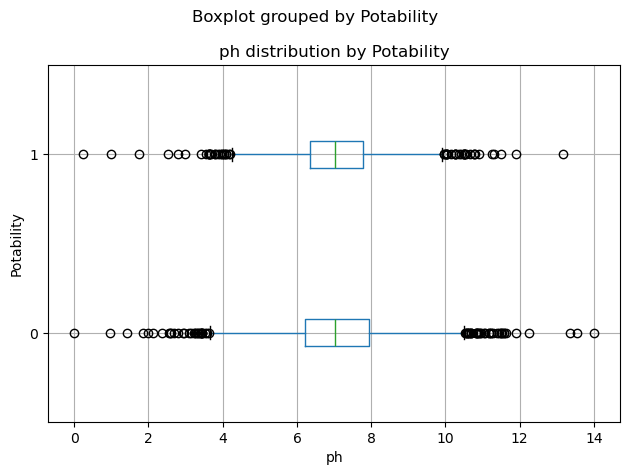

<Figure size 800x600 with 0 Axes>

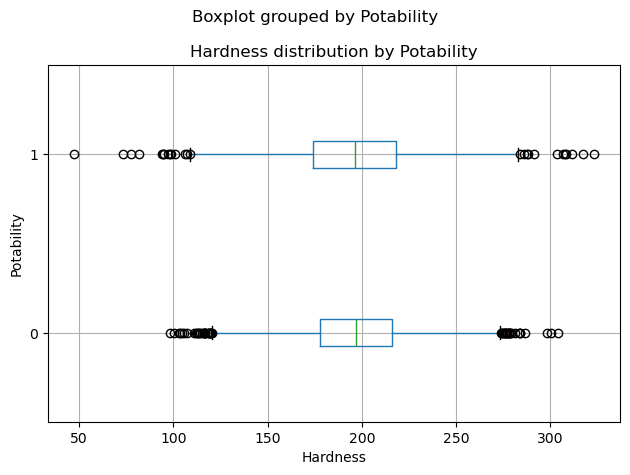

<Figure size 800x600 with 0 Axes>

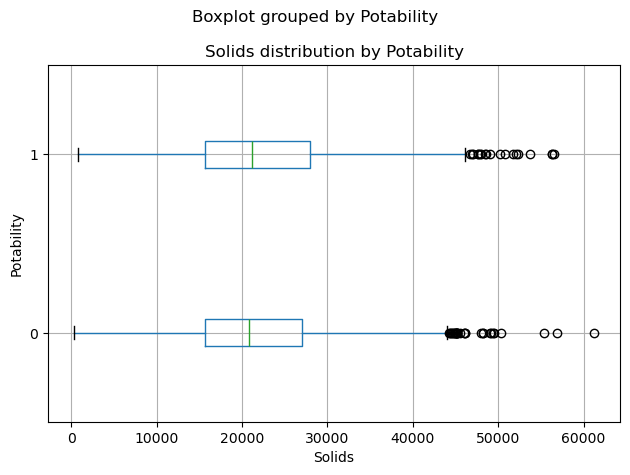

<Figure size 800x600 with 0 Axes>

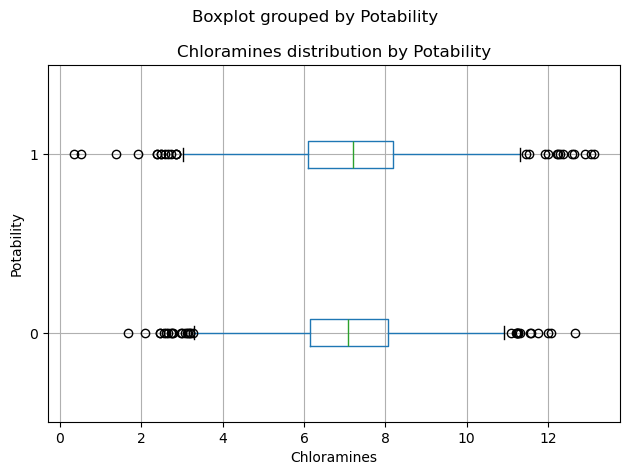

<Figure size 800x600 with 0 Axes>

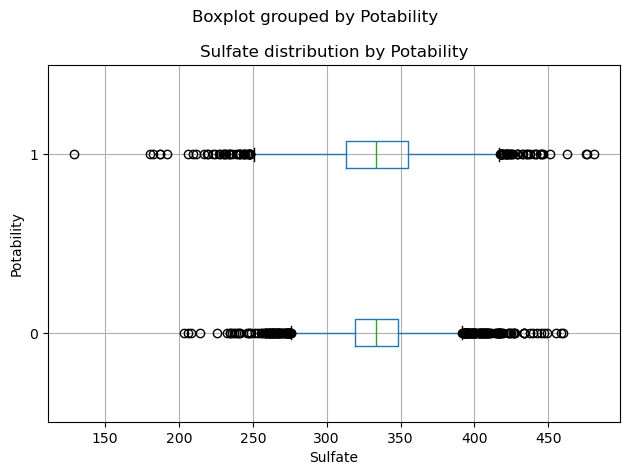

<Figure size 800x600 with 0 Axes>

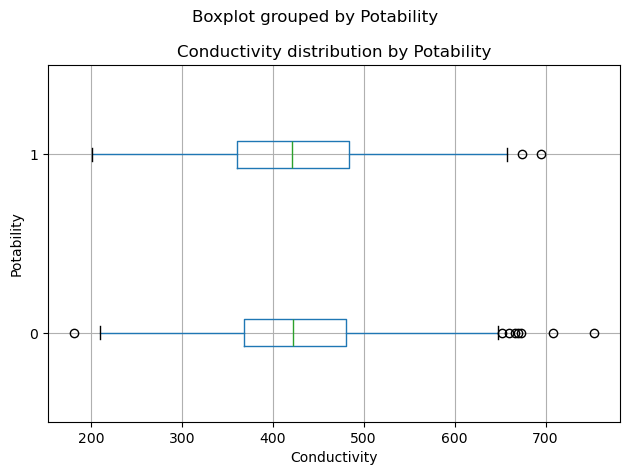

<Figure size 800x600 with 0 Axes>

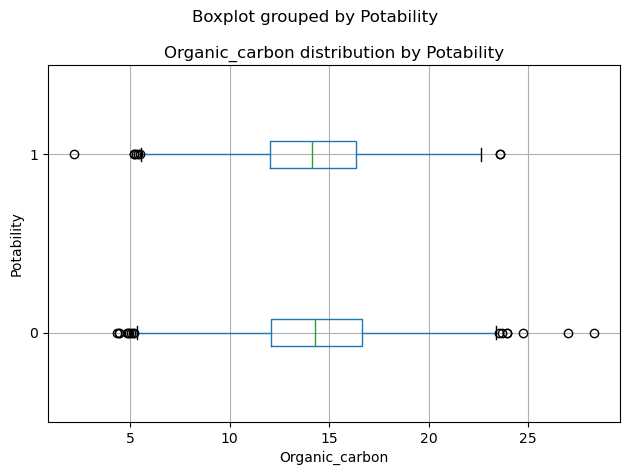

<Figure size 800x600 with 0 Axes>

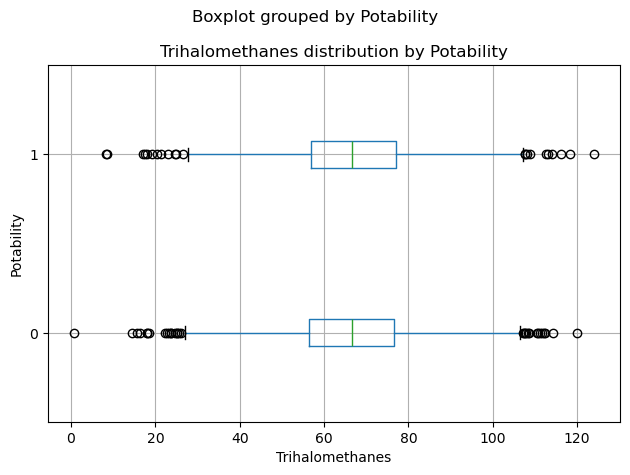

<Figure size 800x600 with 0 Axes>

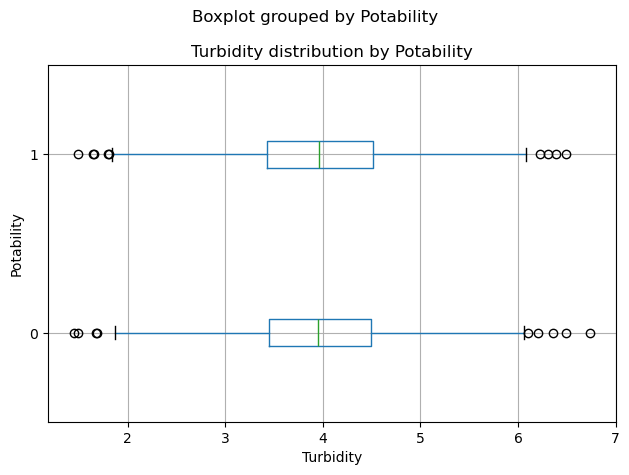

In [28]:
# Group by 'Potability' and plot box plots for each feature
for feature in features:
    plt.figure(figsize=(8, 6))
    df.boxplot(column=feature, by='Potability', vert=False)
    plt.title(f'{feature} distribution by Potability')
    plt.xlabel(feature)
    plt.ylabel('Potability')
    plt.tight_layout()
    plt.show()

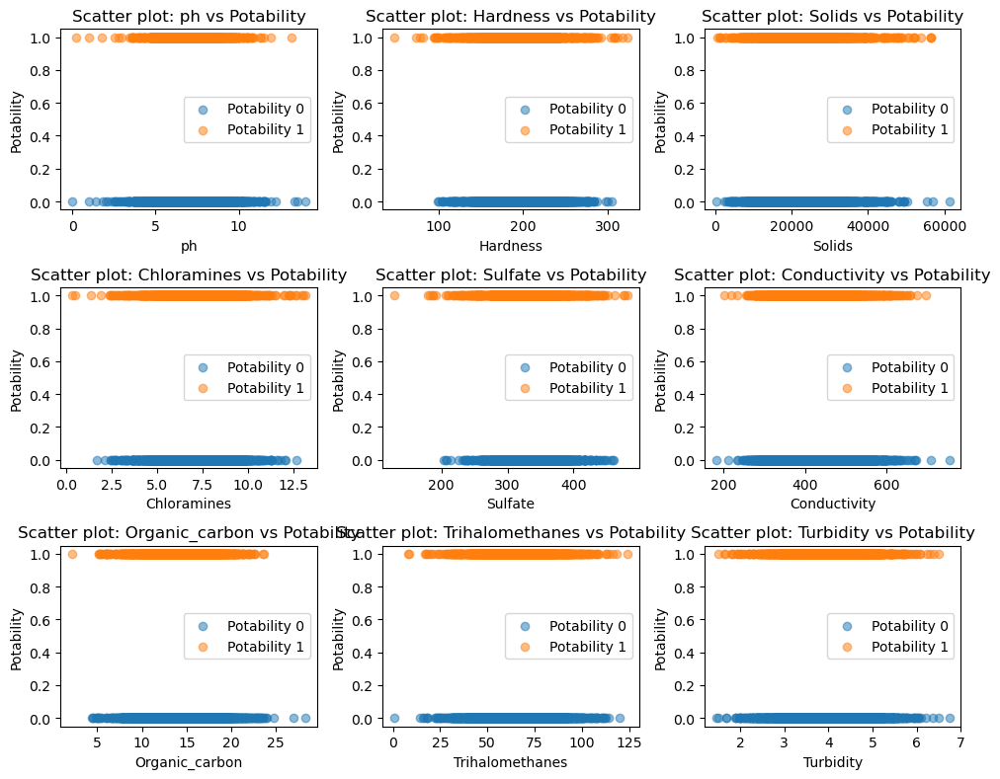

In [29]:
# Set the figure size for the plots
plt.figure(figsize=(10, 8))

# Loop through each feature and create scatter plots
for i, feature in enumerate(features, start=1):
    plt.subplot(3, 3, i)
    plt.scatter(df[df['Potability'] == 0][feature], df[df['Potability'] == 0]['Potability'], label='Potability 0', alpha=0.5)
    plt.scatter(df[df['Potability'] == 1][feature], df[df['Potability'] == 1]['Potability'], label='Potability 1', alpha=0.5)
    plt.title(f'Scatter plot: {feature} vs Potability')
    plt.xlabel(feature)
    plt.ylabel('Potability')
    plt.legend()

plt.tight_layout()
plt.show()

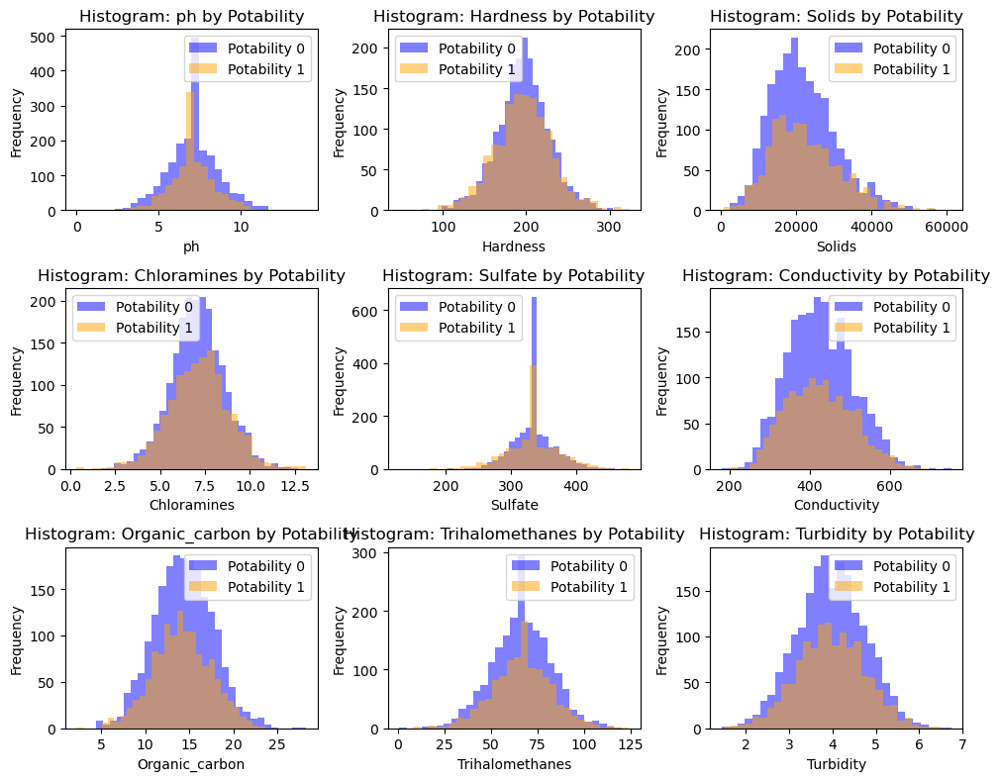

In [30]:
# Set the figure size for the plots
plt.figure(figsize=(10, 8))

# Loop through each feature and create histograms
for i, feature in enumerate(features, start=1):
    plt.subplot(3, 3, i)
    plt.hist(df[df['Potability'] == 0][feature], bins=30, alpha=0.5, label='Potability 0', color='blue')
    plt.hist(df[df['Potability'] == 1][feature], bins=30, alpha=0.5, label='Potability 1', color='orange')
    plt.title(f'Histogram: {feature} by Potability')
    plt.xlabel(feature)
    plt.ylabel('Frequency')
    plt.legend()

plt.tight_layout()
plt.show()

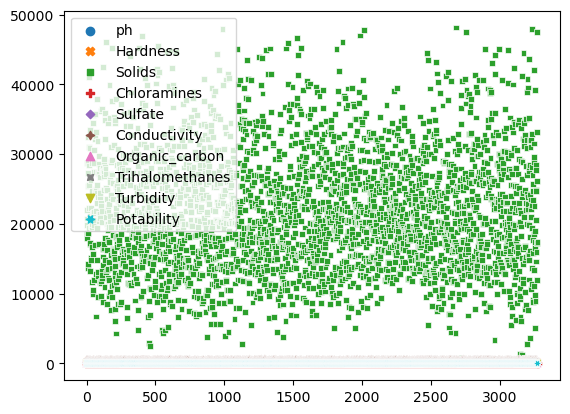

In [31]:
sns.scatterplot(dfz)
plt.show()

<Figure size 1000x800 with 0 Axes>

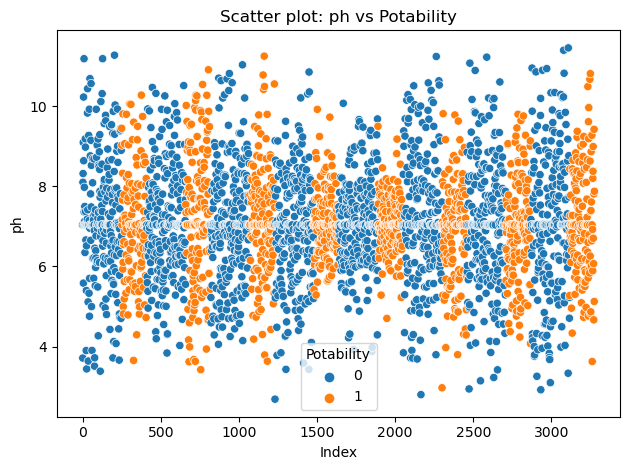

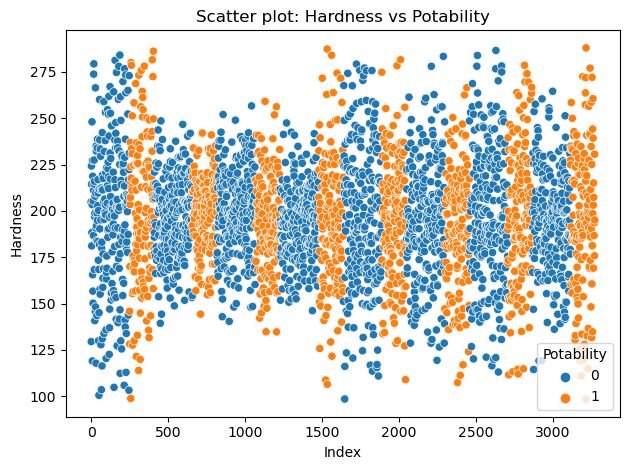

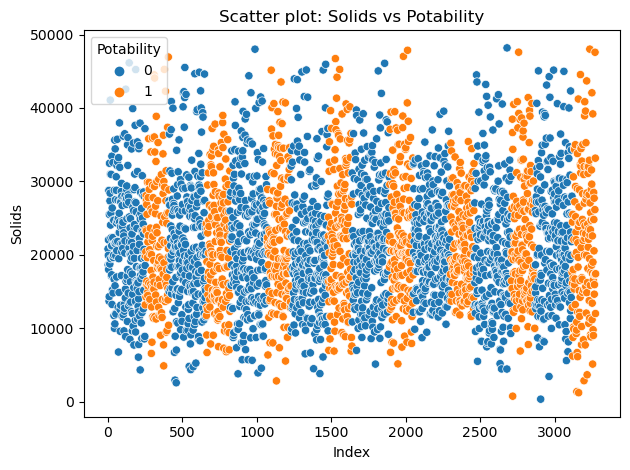

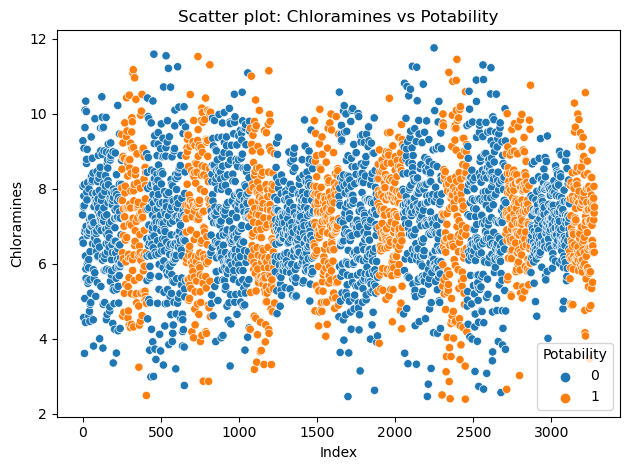

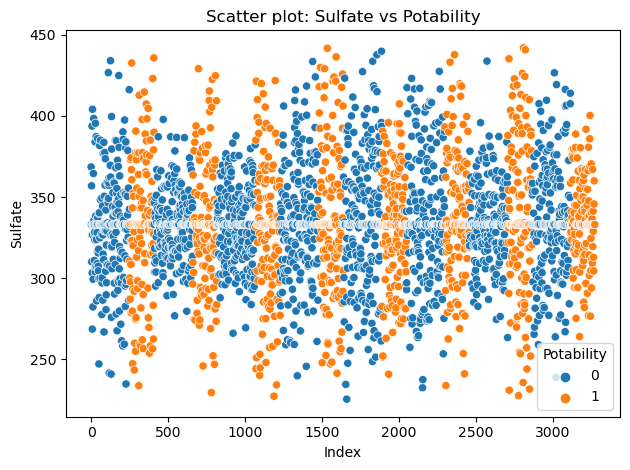

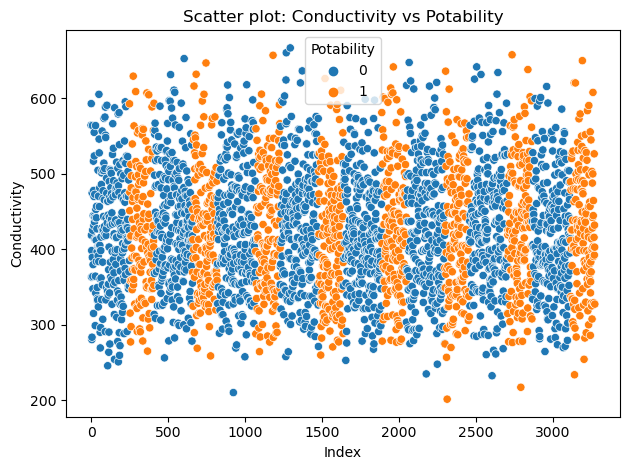

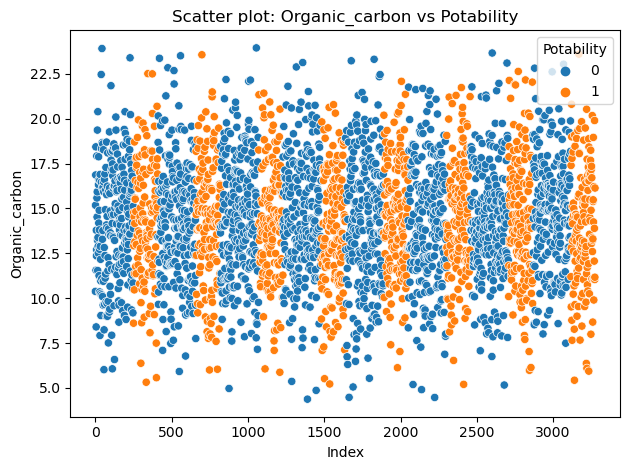

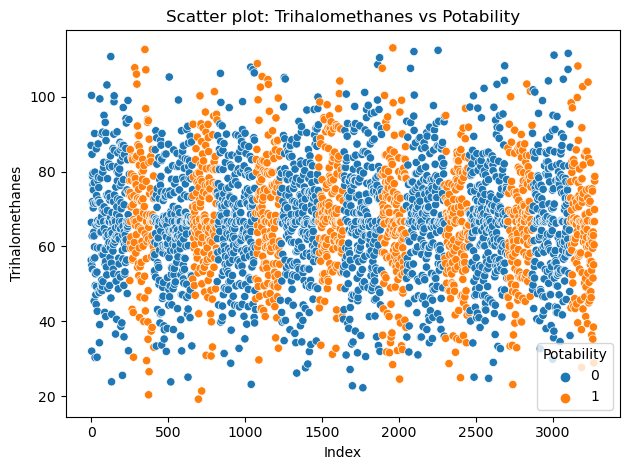

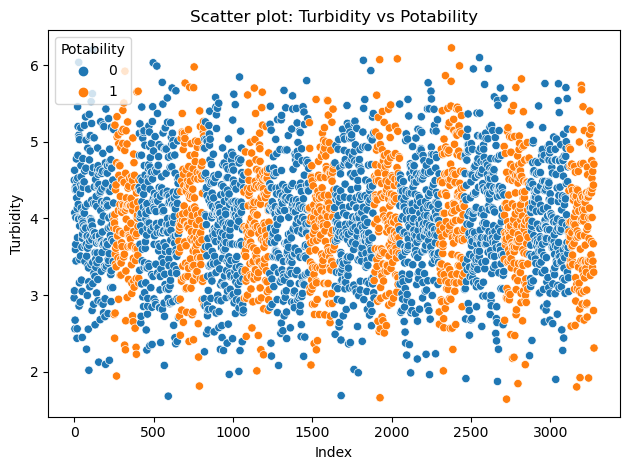

In [32]:
# Set the figure size for the plots
plt.figure(figsize=(10, 8))

# Loop through each column and create scatter plots
for column in columns_to_plot:
    plt.figure()
    sns.scatterplot(data=dfz, x=dfz.index, y=column, hue='Potability')
    plt.title(f'Scatter plot: {column} vs Potability')
    plt.xlabel('Index')
    plt.ylabel(column)
    plt.legend(title='Potability')
    plt.tight_layout()

plt.show()

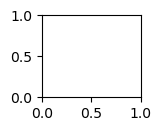

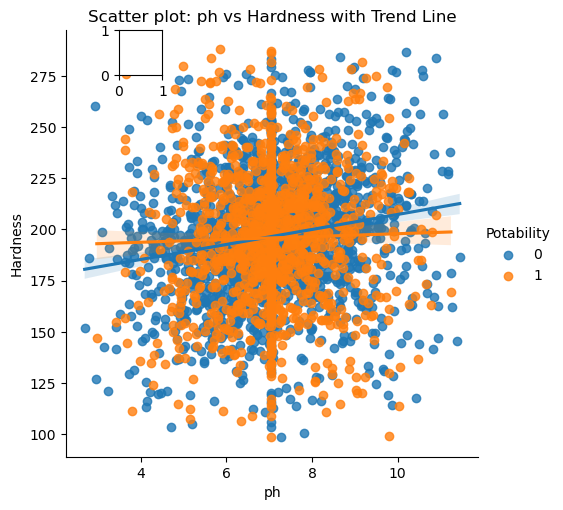

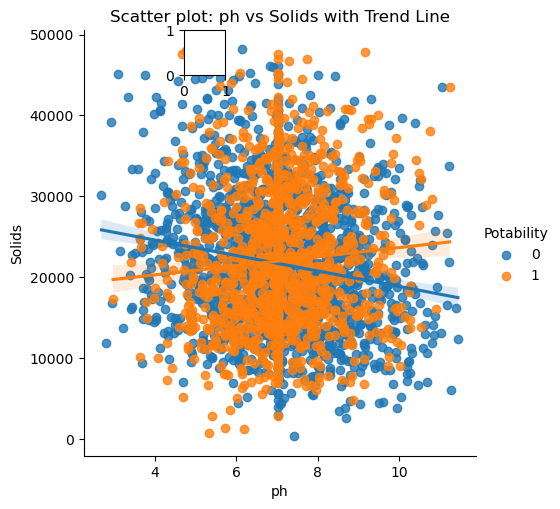

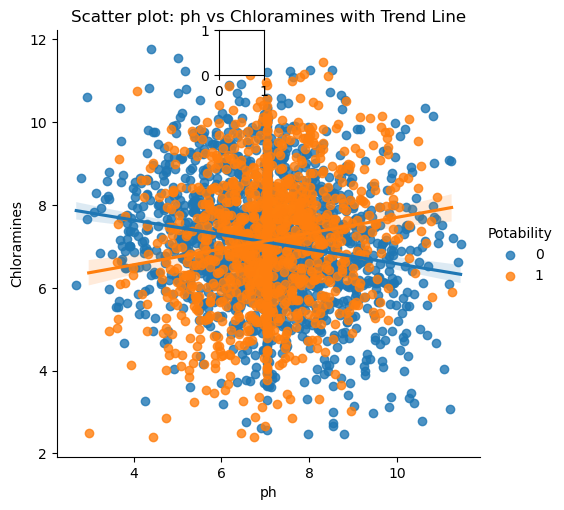

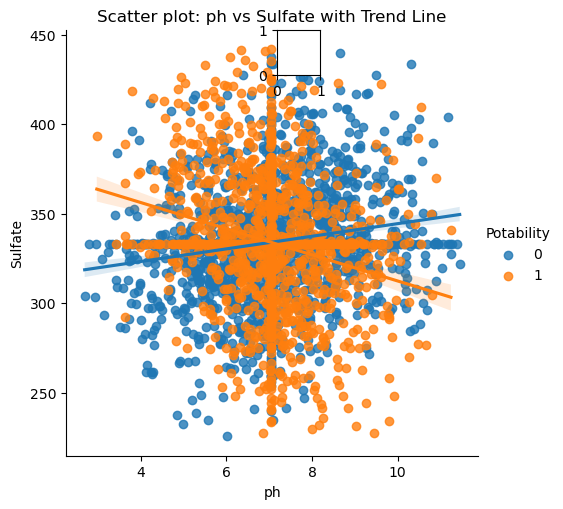

...

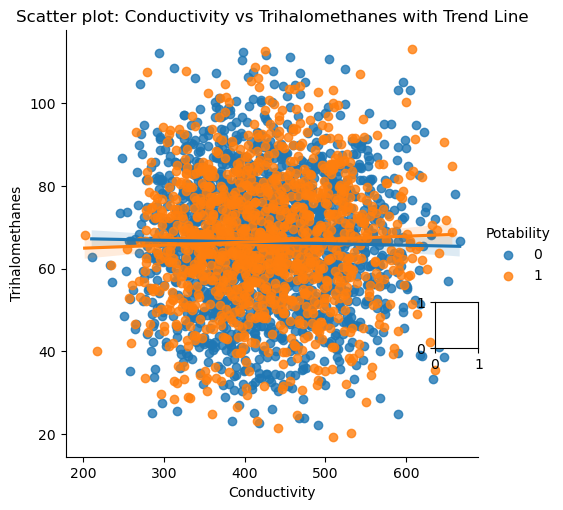

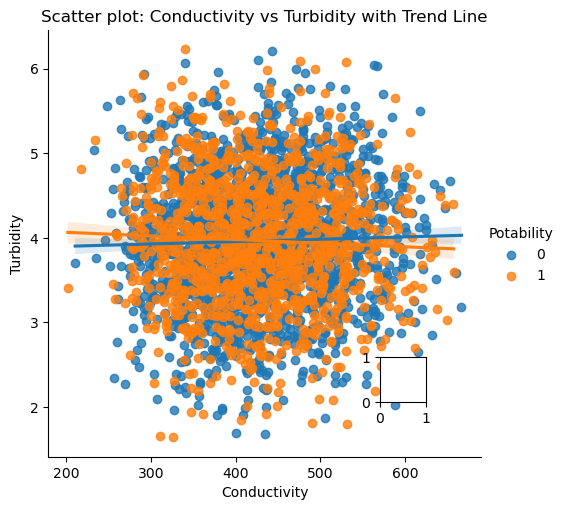

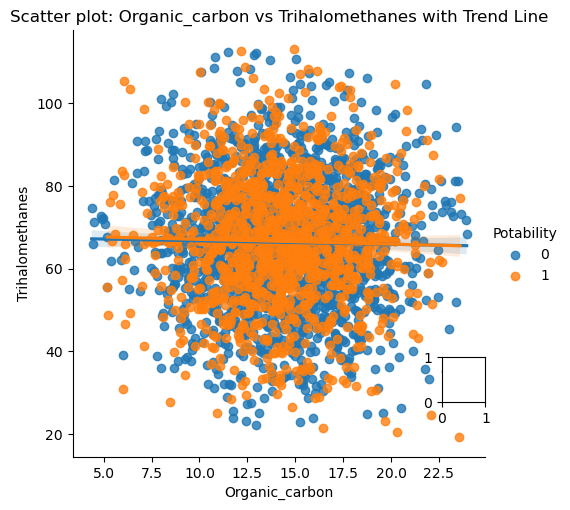

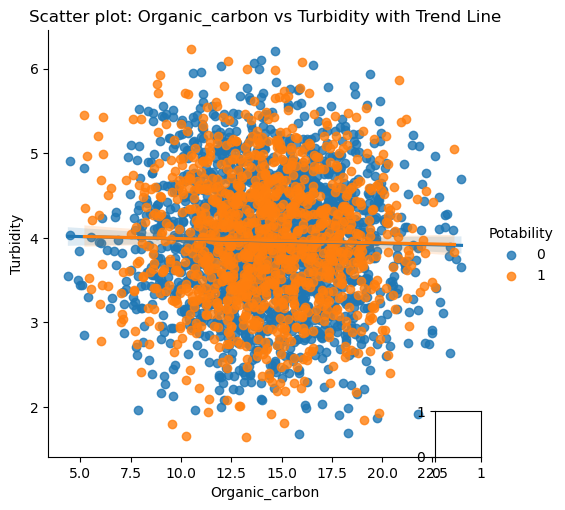

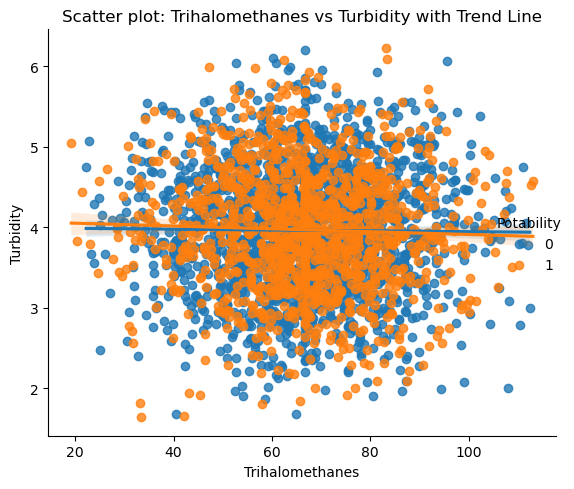

In [33]:
# List of features to plot against the target column 'Potability'
features = ['ph', 'Hardness', 'Solids', 'Chloramines', 'Sulfate', 
            'Conductivity', 'Organic_carbon', 'Trihalomethanes', 'Turbidity']

# Set the figure size for the plots
plt.figure(figsize=(12, 10))

# Loop through pairs of features and create scatter plots with trend lines
for i in range(len(features) - 1):
    for j in range(i + 1, len(features)):
        plt.subplot(len(features) - 1, len(features) - 1, i * (len(features) - 1) + j)
        sns.lmplot(data=dfz, x=features[i], y=features[j], hue='Potability', fit_reg=True)
        plt.title(f'Scatter plot: {features[i]} vs {features[j]} with Trend Line')
        plt.xlabel(features[i])
        plt.ylabel(features[j])

plt.tight_layout()
plt.show()